# **Predicting incidents** 

# Necessary libraries & datasets

First, we load all the packages that are needed for the project:

In [1]:
# Standard libraries
import datetime, warnings
import time
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib.patches import ConnectionPatch
from collections import OrderedDict
from matplotlib.gridspec import GridSpec
from pprint import pprint

# Applicable sklearn libraries
from sklearn import metrics, linear_model, tree
from sklearn.feature_selection import RFE
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, GridSearchCV, KFold

# RandomForest 
from sklearn.ensemble import RandomForestRegressor 

# GradientBoostRegressor 
from sklearn.ensemble import GradientBoostingRegressor

# Adaboost
from sklearn.ensemble import AdaBoostRegressor

# XGBoost 
from xgboost import XGBRegressor

# CatBoost
from catboost import CatBoostRegressor

plt.rcParams["patch.force_edgecolor"] = True
plt.style.use('fivethirtyeight')
mpl.rc('patch', edgecolor = 'dimgray', linewidth=1)

from IPython.core.interactiveshell import InteractiveShell

InteractiveShell.ast_node_interactivity = "last_expr"
pd.options.display.max_columns = 50
%matplotlib inline
warnings.filterwarnings("ignore")

C:\Users\richa\Anaconda3\lib\site-packages\dask\dataframe\utils.py:14: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [2]:
df_kadaster = pd.read_csv('all_features.csv')
print('Dataframe dimensions:', df_kadaster.shape)
df_kadaster

Dataframe dimensions: (479, 66)


,Unnamed: 0,BuurtCode,Neighborhood,TotalResidents,Age 0-15,% age 0-15,Age 65+,%Age 65+,AverageSizeofHoushold,Population Density,Building year before 2000,Building year after 2000,woning,horeca,winkel,bedrijf_en_kantoor,kerk_en_gebedsruimte,cultuur_en_musea,medisch,bejaardenhuis_tehuis_en_bijzondere_woonfunctie,kinderdagverblijf_en_basisschool,middelbaar_en_speciaal_onderwijs,beroeps_en_wetenschappelijk_onderwijs,garage_en_parkeerplaats,nr_of_rent,...,nr_of_inspections_without_observation,industrie,sport,x,y,lon,lat,gem_gas_woning,gem_gas_woning_cor,gem_elektriciteit_woning,gem_gas_bedrijf,gem_elektriciteit_bedrijf,potent_pand_asbest,gebouwen_gebruik_gas,meer_reg_woning,meer_reg_industrie,hoge_gas_verbruik,hoge_asbest_buurt,hoge_dichtheid_buurt,industrie_buurt,industriegebied,env_effect,Supermarkt,Verzorghuizen,Museum
0,0,BU03630000,Kop Zeedijk,1110.0,45.0,4.054054,100.0,9.009009,1.4,18349,96.0,4.0,162.0,120.0,29.0,18.0,0.0,4.0,0.0,0.0,0.0,0.0,0.0,5.0,195.0,...,24.0,20.0,0.0,121824.740361,487631.554156,4.900018,52.375553,791.0,918.0,1695.0,3402.0,17082.0,19.0,1035.0,743.0,10.0,0.0,1.0,0.0,1.0,1.0,3.0,NaN,NaN,NaN
1,1,BU03630001,Oude Kerk e.o.,695.0,20.0,2.877698,70.0,10.071942,1.4,7910,87.0,13.0,101.0,43.0,24.0,73.0,0.0,3.0,0.0,0.0,1.0,0.0,0.0,1.0,150.0,...,52.0,106.0,0.0,121595.371677,487447.889546,4.896668,52.373888,732.0,850.0,1591.0,5048.0,31608.0,32.0,765.0,513.0,102.0,0.0,1.0,0.0,1.0,1.0,3.0,NaN,NaN,NaN
2,2,BU03630002,Burgwallen Oost,1645.0,90.0,5.471125,180.0,10.942249,1.4,26460,96.0,4.0,274.0,47.0,53.0,73.0,1.0,2.0,0.0,0.0,0.0,0.0,0.0,2.0,298.0,...,30.0,41.0,0.0,121736.890103,487329.844480,4.898758,52.372836,901.0,1045.0,1816.0,2571.0,12513.0,25.0,1459.0,1027.0,32.0,0.0,1.0,1.0,1.0,1.0,4.0,NaN,NaN,NaN
3,3,BU03630003,Nes e.o.,365.0,25.0,6.849315,30.0,8.219178,1.5,6883,98.0,2.0,53.0,48.0,41.0,74.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,111.0,...,33.0,12.0,0.0,121415.085604,487117.492764,4.894054,52.370908,882.0,1021.0,1745.0,4927.0,30261.0,4.0,425.0,240.0,3.0,0.0,0.0,0.0,1.0,1.0,2.0,NaN,NaN,NaN
4,4,BU03630004,BG-terrein e.o.,690.0,40.0,5.797101,80.0,11.594203,1.4,8161,100.0,0.0,97.0,18.0,8.0,10.0,0.0,1.0,0.0,0.0,0.0,0.0,5.0,1.0,97.0,...,45.0,8.0,0.0,121534.142532,487008.012912,4.895813,52.369931,954.0,1108.0,1880.0,4356.0,24764.0,0.0,515.0,367.0,4.0,0.0,0.0,0.0,1.0,1.0,2.0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
474,474,BU03639701,Gein Zuidwest,1665.0,310.0,18.618619,125.0,7.507508,1.9,9544,100.0,0.0,209.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,170.0,...,1.0,2.0,0.0,127571.049934,478601.865966,4.985137,52.294716,964.0,1118.0,2089.0,0.0,381.0,0.0,755.0,747.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN
475,475,BU03639702,Gein Noordoost,3245.0,450.0,13.867488,660.0,20.338983,2.3,5109,100.0,0.0,147.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,20.0,...,0.0,0.0,0.0,128208.920095,479088.995253,4.994448,52.299125,989.0,1147.0,3025.0,0.0,0.0,0.0,1264.0,1245.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,NaN,NaN,NaN
476,476,BU03639703,Gein Zuidoost,3355.0,510.0,15.201192,630.0,18.777943,2.0,4676,100.0,0.0,266.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,218.0,...,0.0,0.0,0.0,127916.351954,478425.038846,4.990213,52.293144,1009.0,1171.0,2458.0,0.0,0.0,0.0,1563.0,1527.0,0.0,1.0,0.0,1.0,0.0,0.0,2.0,NaN,NaN,NaN
477,477,BU03639800,Dorp Driemond,1480.0,265.0,17.905405,275.0,18.581081,2.3,5099,94.0,6.0,92.0,0.0,0.0,6.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,57.0,...,2.0,4.0,0.0,129716.746223,479805.037571,5.016499,52.305632,1120.0,1301.0,2837.0,0.0,871.0,249.0,676.0,630.0,3.0,1.0,1.0,0.0,1.0,1.0,4.0,NaN,NaN,NaN


In [3]:
df_building = pd.read_csv('building_year_set.csv').rename(columns = {'buurtnaam':'Neighborhood'})
print('Dataframe dimensions:', df_building.shape)
df_building

Dataframe dimensions: (477, 7)


,Unnamed: 0,Neighborhood,before_1940,1940-1959,1960-1979,1980-1999,after_2000
0,0,,1,0,0,1,480
1,1,AMC,0,0,0,23,14
2,2,Aalsmeerwegbuurt Oost,1224,0,0,90,16
3,3,Aalsmeerwegbuurt West,1510,2,0,0,0
4,4,Afrikahaven,0,0,0,3,102
...,...,...,...,...,...,...,...
472,472,Zuidwestkwadrant Osdorp Noord,1,0,347,84,937
473,473,Zuidwestkwadrant Osdorp Zuid,0,0,313,342,2000
474,474,Zunderdorp,29,7,51,59,80
475,475,Zwarte Gouw,0,0,16,2,16


In [4]:
df_features = pd.merge(df_kadaster, df_building, on = 'Neighborhood')
df_features

,Unnamed: 0_x,BuurtCode,Neighborhood,TotalResidents,Age 0-15,% age 0-15,Age 65+,%Age 65+,AverageSizeofHoushold,Population Density,Building year before 2000,Building year after 2000,woning,horeca,winkel,bedrijf_en_kantoor,kerk_en_gebedsruimte,cultuur_en_musea,medisch,bejaardenhuis_tehuis_en_bijzondere_woonfunctie,kinderdagverblijf_en_basisschool,middelbaar_en_speciaal_onderwijs,beroeps_en_wetenschappelijk_onderwijs,garage_en_parkeerplaats,nr_of_rent,...,lat,gem_gas_woning,gem_gas_woning_cor,gem_elektriciteit_woning,gem_gas_bedrijf,gem_elektriciteit_bedrijf,potent_pand_asbest,gebouwen_gebruik_gas,meer_reg_woning,meer_reg_industrie,hoge_gas_verbruik,hoge_asbest_buurt,hoge_dichtheid_buurt,industrie_buurt,industriegebied,env_effect,Supermarkt,Verzorghuizen,Museum,Unnamed: 0_y,before_1940,1940-1959,1960-1979,1980-1999,after_2000
0,0,BU03630000,Kop Zeedijk,1110.0,45.0,4.054054,100.0,9.009009,1.4,18349,96.0,4.0,162.0,120.0,29.0,18.0,0.0,4.0,0.0,0.0,0.0,0.0,0.0,5.0,195.0,...,52.375553,791.0,918.0,1695.0,3402.0,17082.0,19.0,1035.0,743.0,10.0,0.0,1.0,0.0,1.0,1.0,3.0,NaN,NaN,NaN,221,829,13,10,113,37
1,1,BU03630001,Oude Kerk e.o.,695.0,20.0,2.877698,70.0,10.071942,1.4,7910,87.0,13.0,101.0,43.0,24.0,73.0,0.0,3.0,0.0,0.0,1.0,0.0,0.0,1.0,150.0,...,52.373888,732.0,850.0,1591.0,5048.0,31608.0,32.0,765.0,513.0,102.0,0.0,1.0,0.0,1.0,1.0,3.0,NaN,NaN,NaN,315,648,8,29,101,101
2,2,BU03630002,Burgwallen Oost,1645.0,90.0,5.471125,180.0,10.942249,1.4,26460,96.0,4.0,274.0,47.0,53.0,73.0,1.0,2.0,0.0,0.0,0.0,0.0,0.0,2.0,298.0,...,52.372836,901.0,1045.0,1816.0,2571.0,12513.0,25.0,1459.0,1027.0,32.0,0.0,1.0,1.0,1.0,1.0,4.0,NaN,NaN,NaN,76,1290,14,23,92,40
3,3,BU03630003,Nes e.o.,365.0,25.0,6.849315,30.0,8.219178,1.5,6883,98.0,2.0,53.0,48.0,41.0,74.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,111.0,...,52.370908,882.0,1021.0,1745.0,4927.0,30261.0,4.0,425.0,240.0,3.0,0.0,0.0,0.0,1.0,1.0,2.0,NaN,NaN,NaN,272,396,0,4,33,22
4,4,BU03630004,BG-terrein e.o.,690.0,40.0,5.797101,80.0,11.594203,1.4,8161,100.0,0.0,97.0,18.0,8.0,10.0,0.0,1.0,0.0,0.0,0.0,0.0,5.0,1.0,97.0,...,52.369931,954.0,1108.0,1880.0,4356.0,24764.0,0.0,515.0,367.0,4.0,0.0,0.0,0.0,1.0,1.0,2.0,NaN,NaN,NaN,24,435,0,0,104,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
470,474,BU03639701,Gein Zuidwest,1665.0,310.0,18.618619,125.0,7.507508,1.9,9544,100.0,0.0,209.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,170.0,...,52.294716,964.0,1118.0,2089.0,0.0,381.0,0.0,755.0,747.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,161,18,0,0,744,0
471,475,BU03639702,Gein Noordoost,3245.0,450.0,13.867488,660.0,20.338983,2.3,5109,100.0,0.0,147.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,20.0,...,52.299125,989.0,1147.0,3025.0,0.0,0.0,0.0,1264.0,1245.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,NaN,NaN,NaN,158,0,0,0,1262,1
472,476,BU03639703,Gein Zuidoost,3355.0,510.0,15.201192,630.0,18.777943,2.0,4676,100.0,0.0,266.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,218.0,...,52.293144,1009.0,1171.0,2458.0,0.0,0.0,0.0,1563.0,1527.0,0.0,1.0,0.0,1.0,0.0,0.0,2.0,NaN,NaN,NaN,160,1,0,0,1561,0
473,477,BU03639800,Dorp Driemond,1480.0,265.0,17.905405,275.0,18.581081,2.3,5099,94.0,6.0,92.0,0.0,0.0,6.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,57.0,...,52.305632,1120.0,1301.0,2837.0,0.0,871.0,249.0,676.0,630.0,3.0,1.0,1.0,0.0,1.0,1.0,4.0,NaN,NaN,NaN,124,146,45,248,202,40


In [5]:
pd.set_option('display.max_rows', 73)
df_features.dtypes

Unnamed: 0_x                                        int64
BuurtCode                                          object
Neighborhood                                       object
TotalResidents                                    float64
Age 0-15                                          float64
% age 0-15                                        float64
Age 65+                                           float64
%Age 65+                                          float64
AverageSizeofHoushold                              object
Population Density                                 object
Building year before 2000                         float64
Building year after 2000                          float64
woning                                            float64
horeca                                            float64
winkel                                            float64
bedrijf_en_kantoor                                float64
kerk_en_gebedsruimte                              float64
cultuur_en_mus

___
## 1. Cleaning
___
### 1.1 Filling factor

Examining how complete the dataset is: 

In [6]:
missing_df = df_features.isnull().sum(axis = 0).reset_index()
missing_df.columns = ['variable', 'missing values']
missing_df['filling factor (%)'] = (df_features.shape[0] - missing_df['missing values'])/df_features.shape[0] * 100
missing_df.sort_values('filling factor (%)').reset_index(drop = True)
missing_df

,variable,missing values,filling factor (%)
0,Unnamed: 0_x,0,100.000000
1,BuurtCode,0,100.000000
2,Neighborhood,0,100.000000
3,TotalResidents,0,100.000000
4,Age 0-15,0,100.000000
5,% age 0-15,16,96.631579
6,Age 65+,0,100.000000
7,%Age 65+,15,96.842105
8,AverageSizeofHoushold,0,100.000000
9,Population Density,0,100.000000


As you can see, there are some missing values within the dataset, so these ones will be encoded to 0 instead of NaN. 

In [7]:
df_features = df_features.fillna(0)

missing_df = df_features.isnull().sum(axis = 0).reset_index()
missing_df.columns = ['variable', 'missing values']
missing_df['filling factor (%)'] = (df_features.shape[0] - missing_df['missing values'])/df_features.shape[0] * 100
missing_df.sort_values('filling factor (%)').reset_index(drop = True)
missing_df

,variable,missing values,filling factor (%)
0,Unnamed: 0_x,0,100.0
1,BuurtCode,0,100.0
2,Neighborhood,0,100.0
3,TotalResidents,0,100.0
4,Age 0-15,0,100.0
5,% age 0-15,0,100.0
6,Age 65+,0,100.0
7,%Age 65+,0,100.0
8,AverageSizeofHoushold,0,100.0
9,Population Density,0,100.0


In [8]:
df_features = df_features.replace('       .', np.nan)

Now everything is filled up and '       .' are converted to NaN. 

### 1.2 Data preprocessing


In [9]:
# See which features have a contribution to the "incident" and which not within the features set

corr_matrix = df_features.corr()
corr_matrix['incident'].sort_values(ascending = False)

incident                                          1.000000
TotalResidents                                    0.706040
meer_reg_woning                                   0.702646
nr_of_rent                                        0.688940
gebouwen_gebruik_gas                              0.661538
woning                                            0.646861
hoge_dichtheid_buurt                              0.605723
Age 0-15                                          0.598183
nr_of_tussengebouw                                0.588237
Age 65+                                           0.543105
nr_of_possession                                  0.529680
nr_of_hoekgebouw                                  0.405282
winkel                                            0.390832
potent_pand_asbest                                0.383408
before_1940                                       0.363600
env_effect                                        0.345748
nr_of_monuments                                   0.3138

In [10]:
df_features_clean = df_features[["TotalResidents", "% age 0-15", "%Age 65+", "AverageSizeofHoushold", "Population Density", 
                                 "Building year before 2000", "floorsize_accomodation", "env_effect", "nr_of_monuments", 
                                 "cultuur_en_musea", "incident"]].copy()
df_features_clean

,TotalResidents,% age 0-15,%Age 65+,AverageSizeofHoushold,Population Density,Building year before 2000,floorsize_accomodation,env_effect,nr_of_monuments,cultuur_en_musea,incident
0,1110.0,4.054054,9.009009,1.4,18349,96.0,1716.0,3.0,20.0,4.0,3.0
1,695.0,2.877698,10.071942,1.4,7910,87.0,117.0,3.0,23.0,3.0,8.0
2,1645.0,5.471125,10.942249,1.4,26460,96.0,86.0,4.0,12.0,2.0,8.0
3,365.0,6.849315,8.219178,1.5,6883,98.0,442.0,2.0,69.0,1.0,5.0
4,690.0,5.797101,11.594203,1.4,8161,100.0,680.0,2.0,32.0,1.0,3.0
...,...,...,...,...,...,...,...,...,...,...,...
470,1665.0,18.618619,7.507508,1.9,9544,100.0,93.0,0.0,0.0,1.0,3.0
471,3245.0,13.867488,20.338983,2.3,5109,100.0,80.0,1.0,0.0,0.0,6.0
472,3355.0,15.201192,18.777943,2.0,4676,100.0,74.0,2.0,0.0,0.0,7.0
473,1480.0,17.905405,18.581081,2.3,5099,94.0,73.0,4.0,0.0,0.0,0.0


We also need to check if there are infinite values that need to be converted. That is something which will be done with the function below. 

In [11]:
def clean_data(df):
    assert isinstance(df, pd.DataFrame), "df needs to be a dataframe"
    df.dropna(inplace = True)
    indices = ~df.isin([np.nan, np.inf, -np.inf]).any(1)
    return df[indices].astype(np.float64)

In [12]:
df_features_clean = clean_data(df_features_clean)

In [13]:
X = df_features_clean.drop(columns = 'incident')
X[['AverageSizeofHoushold', 'Population Density']] = X[['AverageSizeofHoushold', 'Population Density']].astype(float)

y = df_features_clean.incident

___
## 2. Predicting incidents
### 2.1 Train-test split (hold-out)

In [14]:
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state = 0, test_size = 0.35)

### 2.1.1 Random forest

In [15]:
start_time = time.time()

reg_rf = RandomForestRegressor()
reg_rf.fit(X_train, y_train)

finish_time = time.time()
total_time = finish_time - start_time

print('Elapsed time: ', total_time)

Elapsed time:  0.18999910354614258


In [16]:
y_pred = reg_rf.predict(X_test)

In [17]:
# R2 score of the model
reg_rf.score(X_train, y_train)

0.9296102013948866

In [18]:
# Prediction score between incidents from test set and predicted incidents: mean absolute errors and (root) mean squared errors
print('MAE:', metrics.mean_absolute_error(y_test, y_pred))
print('MSE:', metrics.mean_squared_error(y_test, y_pred))
print('RMSE:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

MAE: 2.0986624203821655
MSE: 8.940424840764331
RMSE: 2.990054320704614


In [19]:
feature_list = list(X_train.columns)

# Get numerical feature importances
importances = list(reg_rf.feature_importances_)

# List of tuples with variable and importance
feature_importances = [(feature, round(importance, 2)) for feature, importance in zip(feature_list, importances)]

# Sort the feature importances by most important first
feature_importances = sorted(feature_importances, key = lambda x: x[1], reverse = True)

# Print out the feature and importances 
[print('Variable: {:20} Importance: {}'.format(*pair)) for pair in feature_importances]

Variable: TotalResidents       Importance: 0.63
Variable: nr_of_monuments      Importance: 0.09
Variable: %Age 65+             Importance: 0.05
Variable: Population Density   Importance: 0.05
Variable: % age 0-15           Importance: 0.04
Variable: AverageSizeofHoushold Importance: 0.04
Variable: floorsize_accomodation Importance: 0.04
Variable: Building year before 2000 Importance: 0.03
Variable: env_effect           Importance: 0.02
Variable: cultuur_en_musea     Importance: 0.01


[None, None, None, None, None, None, None, None, None, None]

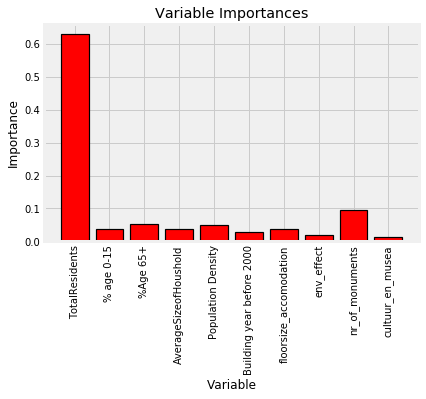

In [20]:
# list of x locations for plotting
x_values = list(range(len(importances)))

# Make a bar chart
plt.bar(x_values, importances, orientation = 'vertical', color = 'r', edgecolor = 'k', linewidth = 1.2)

# Tick labels for x axis
plt.xticks(x_values, feature_list, rotation='vertical')

# Axis labels and title
plt.ylabel('Importance'); plt.xlabel('Variable'); plt.title('Variable Importances');

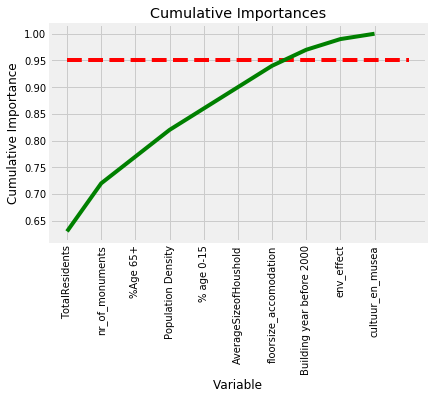

In [21]:
# List of features sorted from most to least important
sorted_importances = [importance[1] for importance in feature_importances]
sorted_features = [importance[0] for importance in feature_importances]

# Cumulative importances
cumulative_importances = np.cumsum(sorted_importances)

# Make a line graph
plt.plot(x_values, cumulative_importances, 'g-')

# Draw line at 95% of importance retained
plt.hlines(y = 0.95, xmin=0, xmax=len(sorted_importances), color = 'r', linestyles = 'dashed')

# Format x ticks and labels
plt.xticks(x_values, sorted_features, rotation = 'vertical')

# Axis labels and title
plt.xlabel('Variable'); plt.ylabel('Cumulative Importance'); plt.title('Cumulative Importances');

In [22]:
print('Number of features for 95% importance:', np.where(cumulative_importances > 0.95)[0][0] + 1)

Number of features for 95% importance: 8


In [23]:
feature_list

['TotalResidents',
 '% age 0-15',
 '%Age 65+',
 'AverageSizeofHoushold',
 'Population Density',
 'Building year before 2000',
 'floorsize_accomodation',
 'env_effect',
 'nr_of_monuments',
 'cultuur_en_musea']

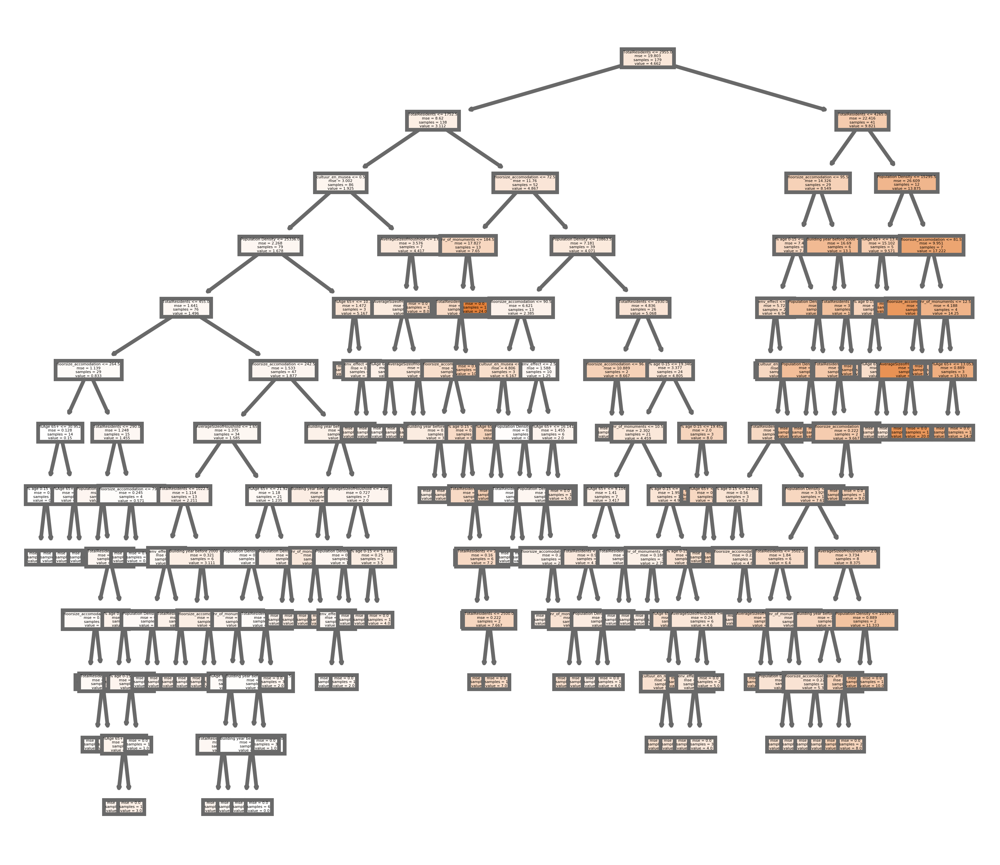

In [24]:
fig, axes = plt.subplots(nrows = 1,ncols = 1,figsize = (4,4), dpi=800)
tree.plot_tree(reg_rf.estimators_[0],
               feature_names = feature_list, 
               class_names = y_test,
               filled = True);

### 2.1.2 AdaBoost

In [25]:
start_time = time.time()

reg_ada = AdaBoostRegressor()
reg_ada.fit(X_train, y_train)

finish_time = time.time()
total_time = finish_time - start_time

print('Elapsed time: ', total_time)

Elapsed time:  0.07999968528747559


In [26]:
y_pred = reg_ada.predict(X_test)

In [27]:
# R2 score of the model
reg_ada.score(X_train, y_train)

0.7791735900955689

In [28]:
# Prediction score between incidents from test set and predicted incidents: mean absolute errors and (root) mean squared errors
print('MAE:', metrics.mean_absolute_error(y_test, y_pred))
print('MSE:', metrics.mean_squared_error(y_test, y_pred))
print('RMSE:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

MAE: 2.3295172616132316
MSE: 9.194418754998381
RMSE: 3.03222999704811


In [29]:
# Get numerical feature importances
importances = list(reg_ada.feature_importances_)

# List of tuples with variable and importance
feature_importances = [(feature, round(importance, 2)) for feature, importance in zip(feature_list, importances)]

# Sort the feature importances by most important first
feature_importances = sorted(feature_importances, key = lambda x: x[1], reverse = True)

# Print out the feature and importances 
[print('Variable: {:20} Importance: {}'.format(*pair)) for pair in feature_importances]

Variable: TotalResidents       Importance: 0.5
Variable: nr_of_monuments      Importance: 0.19
Variable: AverageSizeofHoushold Importance: 0.07
Variable: Population Density   Importance: 0.07
Variable: floorsize_accomodation Importance: 0.05
Variable: env_effect           Importance: 0.05
Variable: % age 0-15           Importance: 0.03
Variable: %Age 65+             Importance: 0.02
Variable: cultuur_en_musea     Importance: 0.02
Variable: Building year before 2000 Importance: 0.01


[None, None, None, None, None, None, None, None, None, None]

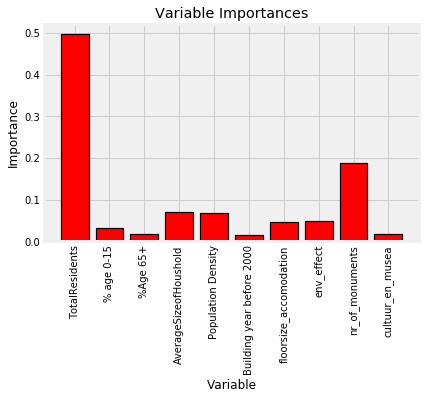

In [30]:
# list of x locations for plotting
x_values = list(range(len(importances)))

# Make a bar chart
plt.bar(x_values, importances, orientation = 'vertical', color = 'r', edgecolor = 'k', linewidth = 1.2)

# Tick labels for x axis
plt.xticks(x_values, feature_list, rotation='vertical')

# Axis labels and title
plt.ylabel('Importance'); plt.xlabel('Variable'); plt.title('Variable Importances');

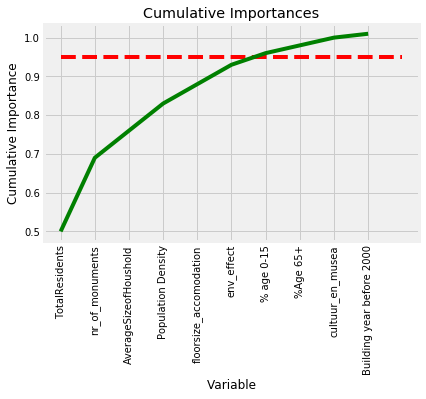

In [31]:
# List of features sorted from most to least important
sorted_importances = [importance[1] for importance in feature_importances]
sorted_features = [importance[0] for importance in feature_importances]

# Cumulative importances
cumulative_importances = np.cumsum(sorted_importances)

# Make a line graph
plt.plot(x_values, cumulative_importances, 'g-')

# Draw line at 95% of importance retained
plt.hlines(y = 0.95, xmin=0, xmax=len(sorted_importances), color = 'r', linestyles = 'dashed')

# Format x ticks and labels
plt.xticks(x_values, sorted_features, rotation = 'vertical')

# Axis labels and title
plt.xlabel('Variable'); plt.ylabel('Cumulative Importance'); plt.title('Cumulative Importances');

In [32]:
print('Number of features for 95% importance:', np.where(cumulative_importances > 0.95)[0][0] + 1)

Number of features for 95% importance: 7


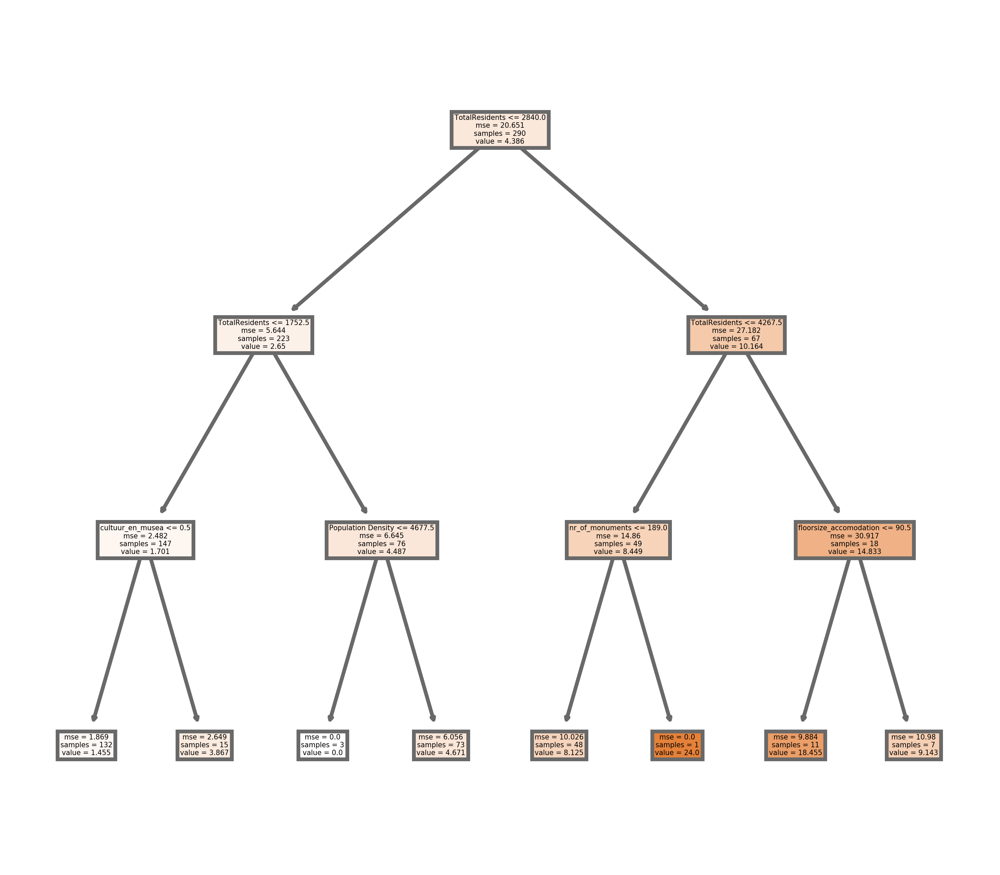

In [33]:
fig, axes = plt.subplots(nrows = 1,ncols = 1,figsize = (4,4), dpi=800)
tree.plot_tree(reg_ada.estimators_[0],
               feature_names = feature_list, 
               class_names = y_test,
               filled = True);

### 2.1.3 Gradient Boosting Tree

In [34]:
start_time = time.time()

reg_gbt = GradientBoostingRegressor()
reg_gbt.fit(X_train, y_train)

finish_time = time.time()
total_time = finish_time - start_time

print('Elapsed time: ', total_time)

Elapsed time:  0.0729985237121582


In [35]:
y_pred = reg_gbt.predict(X_test)

In [36]:
# R2 score of the model
reg_gbt.score(X_train, y_train)

0.9351287699989937

In [37]:
# Prediction score between incidents from test set and predicted incidents: mean absolute errors and (root) mean squared errors
print('MAE:', metrics.mean_absolute_error(y_test, y_pred))
print('MSE:', metrics.mean_squared_error(y_test, y_pred))
print('RMSE:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

MAE: 2.121110643474817
MSE: 8.41326964209523
RMSE: 2.9005636766144662


As noticed from the scores above, the Gradient Boosting Tree (without tweaking the hyperparameters) makes more prediction errors in comparison to the random forest method. 

In [38]:
# Get numerical feature importances
importances = list(reg_gbt.feature_importances_)

# List of tuples with variable and importance
feature_importances = [(feature, round(importance, 2)) for feature, importance in zip(feature_list, importances)]

# Sort the feature importances by most important first
feature_importances = sorted(feature_importances, key = lambda x: x[1], reverse = True)

# Print out the feature and importances 
[print('Variable: {:20} Importance: {}'.format(*pair)) for pair in feature_importances]

Variable: TotalResidents       Importance: 0.64
Variable: nr_of_monuments      Importance: 0.11
Variable: Population Density   Importance: 0.07
Variable: AverageSizeofHoushold Importance: 0.05
Variable: %Age 65+             Importance: 0.03
Variable: % age 0-15           Importance: 0.02
Variable: floorsize_accomodation Importance: 0.02
Variable: env_effect           Importance: 0.02
Variable: cultuur_en_musea     Importance: 0.02
Variable: Building year before 2000 Importance: 0.01


[None, None, None, None, None, None, None, None, None, None]

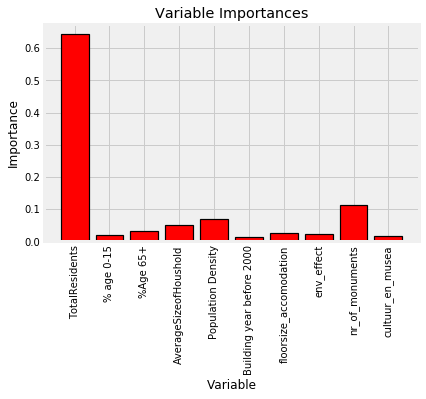

In [39]:
# list of x locations for plotting
x_values = list(range(len(importances)))

# Make a bar chart
plt.bar(x_values, importances, orientation = 'vertical', color = 'r', edgecolor = 'k', linewidth = 1.2)

# Tick labels for x axis
plt.xticks(x_values, feature_list, rotation='vertical')

# Axis labels and title
plt.ylabel('Importance'); plt.xlabel('Variable'); plt.title('Variable Importances');

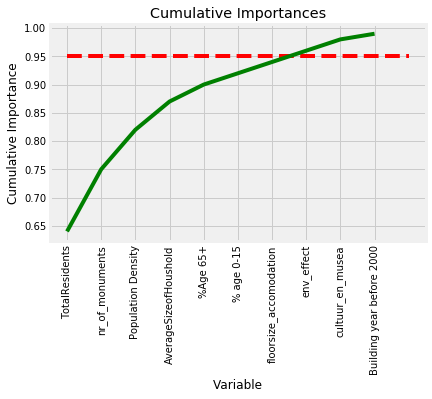

In [40]:
# List of features sorted from most to least important
sorted_importances = [importance[1] for importance in feature_importances]
sorted_features = [importance[0] for importance in feature_importances]

# Cumulative importances
cumulative_importances = np.cumsum(sorted_importances)

# Make a line graph
plt.plot(x_values, cumulative_importances, 'g-')

# Draw line at 95% of importance retained
plt.hlines(y = 0.95, xmin=0, xmax=len(sorted_importances), color = 'r', linestyles = 'dashed')

# Format x ticks and labels
plt.xticks(x_values, sorted_features, rotation = 'vertical')

# Axis labels and title
plt.xlabel('Variable'); plt.ylabel('Cumulative Importance'); plt.title('Cumulative Importances');

In [41]:
print('Number of features for 95% importance:', np.where(cumulative_importances > 0.95)[0][0] + 1)

Number of features for 95% importance: 8


### 2.1.4 XGBoost

In [42]:
start_time = time.time()

reg_xgb = XGBRegressor()
reg_xgb.fit(X_train, y_train)

finish_time = time.time()
total_time = finish_time - start_time

print('Elapsed time: ', total_time)

Elapsed time:  0.23411941528320312


In [43]:
y_pred = reg_xgb.predict(X_test)

In [44]:
# Worse accuracy results on the train set (generalises better than random forest), but quicker to train 

reg_xgb.score(X_train, y_train)

0.9999984351191241

In [45]:
print('MAE:', metrics.mean_absolute_error(y_test, y_pred))
print('MSE:', metrics.mean_squared_error(y_test, y_pred))
print('RMSE:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

MAE: 2.2070890162021493
MSE: 9.233699051299842
RMSE: 3.038700223993779


In [46]:
# Get numerical feature importances
importances = list(reg_xgb.feature_importances_)

# List of tuples with variable and importance
feature_importances = [(feature, round(importance, 2)) for feature, importance in zip(feature_list, importances)]

# Sort the feature importances by most important first
feature_importances = sorted(feature_importances, key = lambda x: x[1], reverse = True)

# Print out the feature and importances 
[print('Variable: {:20} Importance: {}'.format(*pair)) for pair in feature_importances]

Variable: TotalResidents       Importance: 0.33000001311302185
Variable: nr_of_monuments      Importance: 0.1899999976158142
Variable: cultuur_en_musea     Importance: 0.14000000059604645
Variable: AverageSizeofHoushold Importance: 0.09000000357627869
Variable: Population Density   Importance: 0.07000000029802322
Variable: env_effect           Importance: 0.05000000074505806
Variable: Building year before 2000 Importance: 0.03999999910593033
Variable: floorsize_accomodation Importance: 0.03999999910593033
Variable: % age 0-15           Importance: 0.029999999329447746
Variable: %Age 65+             Importance: 0.029999999329447746


[None, None, None, None, None, None, None, None, None, None]

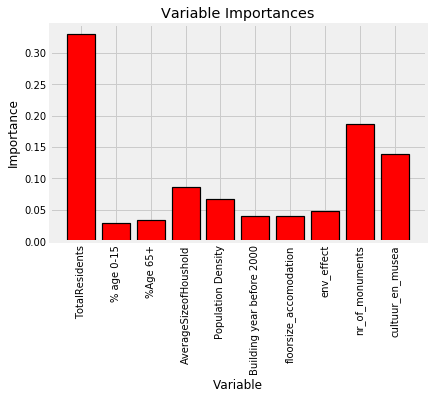

In [47]:
# list of x locations for plotting
x_values = list(range(len(importances)))

# Make a bar chart
plt.bar(x_values, importances, orientation = 'vertical', color = 'r', edgecolor = 'k', linewidth = 1.2)

# Tick labels for x axis
plt.xticks(x_values, feature_list, rotation='vertical')

# Axis labels and title
plt.ylabel('Importance'); plt.xlabel('Variable'); plt.title('Variable Importances');

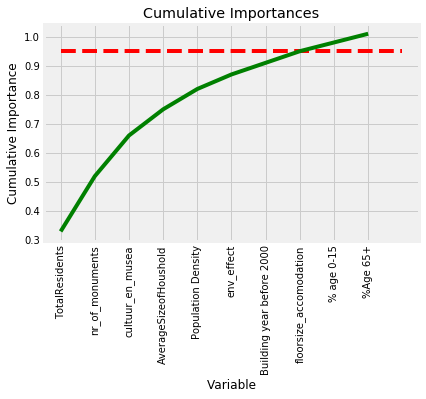

In [48]:
# List of features sorted from most to least important
sorted_importances = [importance[1] for importance in feature_importances]
sorted_features = [importance[0] for importance in feature_importances]

# Cumulative importances
cumulative_importances = np.cumsum(sorted_importances)

# Make a line graph
plt.plot(x_values, cumulative_importances, 'g-')

# Draw line at 95% of importance retained
plt.hlines(y = 0.95, xmin=0, xmax=len(sorted_importances), color = 'r', linestyles = 'dashed')

# Format x ticks and labels
plt.xticks(x_values, sorted_features, rotation = 'vertical')

# Axis labels and title
plt.xlabel('Variable'); plt.ylabel('Cumulative Importance'); plt.title('Cumulative Importances');

In [49]:
print('Number of features for 95% importance:', np.where(cumulative_importances > 0.95)[0][0] + 1)

Number of features for 95% importance: 8


### 2.1.5 CatBoost

In [50]:
start_time = time.time()

reg_cat = CatBoostRegressor()
reg_cat.fit(X_train, y_train)

finish_time = time.time()
total_time = finish_time - start_time

print('Elapsed time: ', total_time)

Learning rate set to 0.03367
0:	learn: 4.6882534	total: 143ms	remaining: 2m 22s
1:	learn: 4.6165401	total: 145ms	remaining: 1m 12s
2:	learn: 4.5488172	total: 146ms	remaining: 48.7s
3:	learn: 4.4864182	total: 149ms	remaining: 37s
4:	learn: 4.4201873	total: 150ms	remaining: 29.8s
5:	learn: 4.3603510	total: 151ms	remaining: 25.1s
6:	learn: 4.3105156	total: 153ms	remaining: 21.7s
7:	learn: 4.2586735	total: 154ms	remaining: 19.1s
8:	learn: 4.2058929	total: 156ms	remaining: 17.1s
9:	learn: 4.1500706	total: 157ms	remaining: 15.5s
10:	learn: 4.0940087	total: 159ms	remaining: 14.3s
11:	learn: 4.0449058	total: 160ms	remaining: 13.2s
12:	learn: 3.9959178	total: 161ms	remaining: 12.3s
13:	learn: 3.9442423	total: 163ms	remaining: 11.5s
14:	learn: 3.8963066	total: 164ms	remaining: 10.8s
15:	learn: 3.8487980	total: 165ms	remaining: 10.1s
16:	learn: 3.8044273	total: 167ms	remaining: 9.63s
17:	learn: 3.7692755	total: 168ms	remaining: 9.18s
18:	learn: 3.7299439	total: 171ms	remaining: 8.81s
19:	learn: 3

In [51]:
y_pred = reg_cat.predict(X_test)

In [52]:
# Worse training results, quicker to train and generalise better than random forest

reg_cat.score(X_train, y_train)

0.99321193180717

In [53]:
print('MAE:', metrics.mean_absolute_error(y_test, y_pred))
print('MSE:', metrics.mean_squared_error(y_test, y_pred))
print('RMSE:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

MAE: 2.253433100072234
MSE: 9.248279254831814
RMSE: 3.041098363228624


In [54]:
# Get numerical feature importances
importances = list(reg_cat.feature_importances_)

# List of tuples with variable and importance
feature_importances = [(feature, round(importance, 2)) for feature, importance in zip(feature_list, importances)]

# Sort the feature importances by most important first
feature_importances = sorted(feature_importances, key = lambda x: x[1], reverse = True)

# Print out the feature and importances 
[print('Variable: {:20} Importance: {}'.format(*pair)) for pair in feature_importances]

Variable: TotalResidents       Importance: 41.33
Variable: Population Density   Importance: 9.74
Variable: %Age 65+             Importance: 8.78
Variable: nr_of_monuments      Importance: 8.32
Variable: % age 0-15           Importance: 6.91
Variable: floorsize_accomodation Importance: 6.33
Variable: AverageSizeofHoushold Importance: 5.54
Variable: env_effect           Importance: 5.43
Variable: Building year before 2000 Importance: 4.74
Variable: cultuur_en_musea     Importance: 2.88


[None, None, None, None, None, None, None, None, None, None]

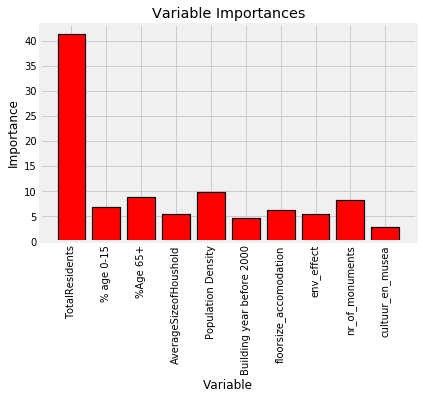

In [55]:
# list of x locations for plotting
x_values = list(range(len(importances)))

# Make a bar chart
plt.bar(x_values, importances, orientation = 'vertical', color = 'r', edgecolor = 'k', linewidth = 1.2)

# Tick labels for x axis
plt.xticks(x_values, feature_list, rotation='vertical')

# Axis labels and title
plt.ylabel('Importance'); plt.xlabel('Variable'); plt.title('Variable Importances');

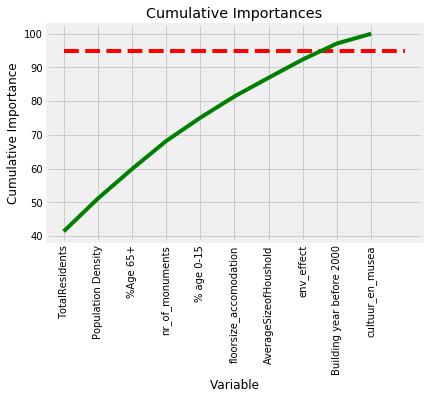

In [56]:
# List of features sorted from most to least important
sorted_importances = [importance[1] for importance in feature_importances]
sorted_features = [importance[0] for importance in feature_importances]

# Cumulative importances
cumulative_importances = np.cumsum(sorted_importances)

# Make a line graph
plt.plot(x_values, cumulative_importances, 'g-')

# Draw line at 95% of importance retained
plt.hlines(y = 95, xmin = 0, xmax = len(sorted_importances), color = 'r', linestyles = 'dashed')

# Format x ticks and labels
plt.xticks(x_values, sorted_features, rotation = 'vertical')

# Axis labels and title
plt.xlabel('Variable'); plt.ylabel('Cumulative Importance'); plt.title('Cumulative Importances');

In [57]:
print('Number of features for 95% importance:', np.where(cumulative_importances > 95)[0][0] + 1)

Number of features for 95% importance: 9


### 2.2 Using Cross-validation
### 2.2.1 Random forest

In [58]:
start_time = time.time()

fold = KFold(n_splits = 5, shuffle = True, random_state = 100)

hyper_params = [{'n_features_to_select': list(range(1, 14))}]

rf_cv = RFE(reg_rf)             

reg_rf_cv = GridSearchCV(estimator = rf_cv, 
                         param_grid = hyper_params, 
                         scoring= 'r2', 
                         cv = fold, 
                         verbose = 1,
                         return_train_score = True)      

reg_rf_cv.fit(X_train, y_train)   

finish_time = time.time()
total_time = finish_time - start_time

print('Elapsed time: ', total_time)

Fitting 5 folds for each of 13 candidates, totalling 65 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  65 out of  65 | elapsed:   39.8s finished


Elapsed time:  40.41413450241089


In [59]:
cv_result = pd.DataFrame(reg_rf_cv.cv_results_)
cv_result

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_features_to_select,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,1.276142,0.019160,0.005830,0.001182,1,{'n_features_to_select': 1},0.536203,0.296114,0.001323,0.444753,0.499150,0.355509,0.195050,13,0.886166,0.897662,0.880666,0.874977,0.856520,0.879198,0.013592
1,1.167941,0.008230,0.005992,0.001078,2,{'n_features_to_select': 2},0.611979,0.325437,0.224395,0.557588,0.567311,0.457342,0.153439,12,0.910842,0.933308,0.920985,0.922174,0.925573,0.922576,0.007274
2,1.052216,0.009233,0.005416,0.000791,3,{'n_features_to_select': 3},0.619766,0.330178,0.340721,0.604870,0.577702,0.494647,0.130725,11,0.925965,0.939043,0.934311,0.922117,0.934708,0.931229,0.006219
3,0.959255,0.022079,0.005230,0.000407,4,{'n_features_to_select': 4},0.628265,0.362427,0.361069,0.635235,0.533295,0.504058,0.121651,10,0.915713,0.943187,0.933659,0.918263,0.923632,0.926891,0.010212
4,0.833740,0.024857,0.005806,0.000752,5,{'n_features_to_select': 5},0.610112,0.378712,0.382680,0.611195,0.551142,0.506768,0.105215,8,0.922639,0.940180,0.935067,0.929620,0.929555,0.931412,0.005897
5,0.694034,0.017440,0.006714,0.000503,6,{'n_features_to_select': 6},0.635787,0.379706,0.345752,0.608612,0.560048,0.505981,0.119937,9,0.931662,0.938777,0.938951,0.927246,0.931877,0.933703,0.004527
6,0.561011,0.006345,0.005609,0.000494,7,{'n_features_to_select': 7},0.615647,0.380446,0.399929,0.602910,0.602875,0.520362,0.106567,6,0.929502,0.942083,0.932460,0.934604,0.934953,0.934720,0.004162
7,0.427529,0.007214,0.005793,0.000765,8,{'n_features_to_select': 8},0.615883,0.435726,0.401715,0.609614,0.602153,0.533018,0.094042,1,0.927950,0.936815,0.939216,0.924982,0.925275,0.930848,0.005992
8,0.282505,0.001565,0.005596,0.000773,9,{'n_features_to_select': 9},0.620177,0.404307,0.368872,0.613383,0.591254,0.519599,0.109596,7,0.932040,0.940542,0.936041,0.922068,0.931702,0.932478,0.006114
9,0.139598,0.001819,0.005589,0.000505,10,{'n_features_to_select': 10},0.618586,0.405127,0.405810,0.620053,0.599675,0.529850,0.101812,3,0.939362,0.942875,0.931211,0.926304,0.929529,0.933856,0.006236


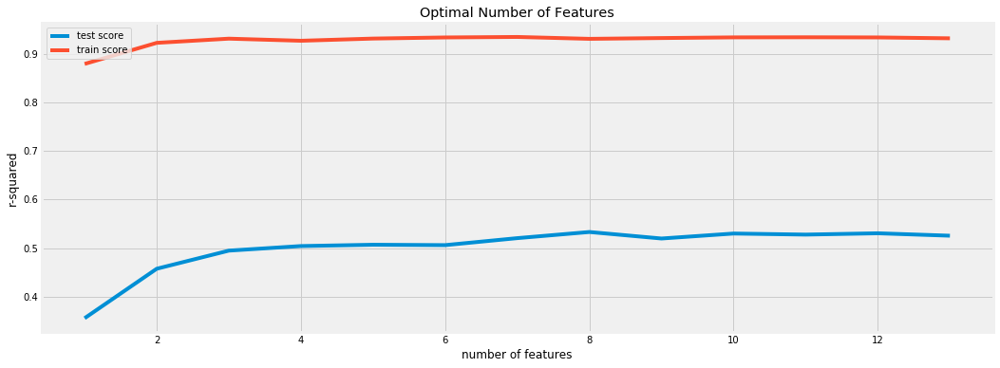

In [60]:
plt.figure(figsize=(16,6))

plt.plot(cv_result["param_n_features_to_select"], cv_result["mean_test_score"])
plt.plot(cv_result["param_n_features_to_select"], cv_result["mean_train_score"])
plt.xlabel('number of features')
plt.ylabel('r-squared')
plt.title("Optimal Number of Features")
plt.legend(['test score', 'train score'], loc='upper left')

Deriving from the plot, 8 features seem like the optimal value of number of feutures to build the final random forest model. Even though the model is performing pretty bad on the test set in comparison to the train set. 

In [61]:
# Final model - Random Forest

start_time = time.time()

n_optimal = 10

rfe = RFE(reg_rf, n_features_to_select = n_optimal)             
reg_rf_optima = rfe.fit(X_train, y_train)

finish_time = time.time()
total_time = finish_time - start_time

print('Elapsed time: ', total_time)

Elapsed time:  0.17895221710205078


In [62]:
# R2 score model with hold-out set 
print(metrics.r2_score(y_train, reg_rf.predict(X_train)))
print(metrics.r2_score(y_test, reg_rf.predict(X_test)))

0.9296102013948866
0.38069421506415846


In [63]:
# R2 score model with optimal RF model 
print(metrics.r2_score(y_train, reg_rf_optima.predict(X_train)))
print(metrics.r2_score(y_test, reg_rf_optima.predict(X_test)))

0.9333939262126456
0.3749631357527863


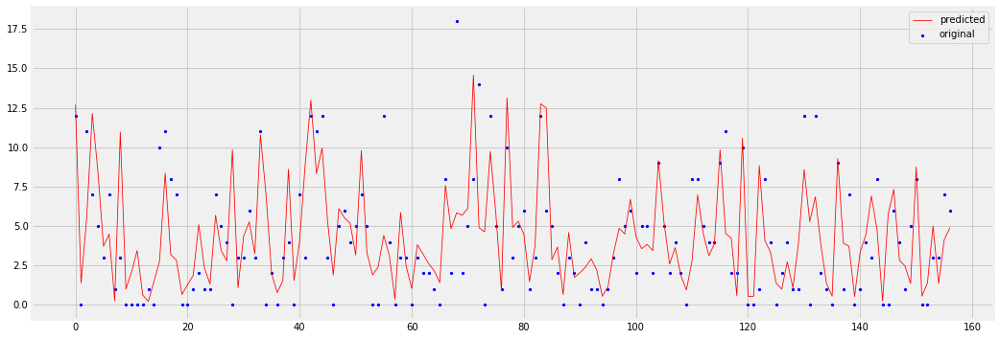

In [64]:
# Plotting performance of the optimal model (few outliers can be identified)

plt.figure(figsize=(16,6))

x_ax = range(len(y_test))
plt.scatter(x_ax, y_test, s = 5, color = "blue", label = "original")
plt.plot(x_ax, reg_rf_optima.predict(X_test), lw = 0.8, color = "red", label = "predicted")
plt.legend()
plt.show()

### 2.2.2 AdaBoost

In [65]:
start_time = time.time()

fold = KFold(n_splits = 5, shuffle = True, random_state = 100) 

hyper_params = [{'n_features_to_select': list(range(1, 14))}]

ada_cv = RFE(reg_ada)             

reg_ada_cv = GridSearchCV(estimator = ada_cv, 
                          param_grid = hyper_params,
                          scoring= 'r2',
                          cv = fold,
                          verbose = 1,
                          return_train_score = True)      

reg_ada_cv.fit(X_train, y_train)   

finish_time = time.time()
total_time = finish_time - start_time

print('Elapsed time: ', total_time)

Fitting 5 folds for each of 13 candidates, totalling 65 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Elapsed time:  16.01971936225891


[Parallel(n_jobs=1)]: Done  65 out of  65 | elapsed:   15.7s finished


In [66]:
cv_result = pd.DataFrame(reg_ada_cv.cv_results_)
cv_result

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_features_to_select,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,0.478169,0.036141,0.002140,0.000286,1,{'n_features_to_select': 1},0.389011,0.303723,0.263130,0.578973,0.518595,0.410686,0.121366,12,0.661516,0.664518,0.673416,0.599141,0.608796,0.641478,0.031026
1,0.443537,0.080762,0.003602,0.000510,2,{'n_features_to_select': 2},0.510671,0.301983,0.291953,0.449555,0.542909,0.419414,0.104426,11,0.659279,0.727027,0.752881,0.707147,0.744269,0.718121,0.033329
2,0.402588,0.066391,0.003813,0.001158,3,{'n_features_to_select': 3},0.572910,0.325705,0.268233,0.283940,0.590798,0.408317,0.143044,13,0.745459,0.710417,0.758083,0.701473,0.761080,0.735302,0.024699
3,0.359197,0.015299,0.003003,0.000632,4,{'n_features_to_select': 4},0.498540,0.510736,0.334327,0.333885,0.574755,0.450449,0.098459,8,0.736149,0.754571,0.783136,0.730289,0.750842,0.750997,0.018412
4,0.328006,0.032543,0.003812,0.000407,5,{'n_features_to_select': 5},0.521949,0.323347,0.351211,0.421381,0.591104,0.441798,0.101361,10,0.748993,0.762784,0.780262,0.731151,0.774711,0.759580,0.017817
5,0.296913,0.013915,0.003591,0.000495,6,{'n_features_to_select': 6},0.525021,0.413707,0.312401,0.434244,0.546571,0.446389,0.084128,9,0.754854,0.751087,0.785117,0.751765,0.758879,0.760340,0.012691
6,0.221202,0.017200,0.003590,0.000488,7,{'n_features_to_select': 7},0.550062,0.479628,0.312430,0.416764,0.620427,0.475862,0.106416,5,0.762335,0.769680,0.790177,0.760264,0.766595,0.769810,0.010698
7,0.174939,0.015372,0.003994,0.000644,8,{'n_features_to_select': 8},0.584941,0.467786,0.342699,0.648782,0.612114,0.531264,0.112084,1,0.764721,0.758041,0.769956,0.765746,0.773360,0.766365,0.005180
8,0.117798,0.002623,0.003607,0.000827,9,{'n_features_to_select': 9},0.548853,0.457319,0.396911,0.419379,0.585846,0.481661,0.073517,3,0.774106,0.770237,0.781912,0.769997,0.745144,0.768279,0.012343
9,0.059939,0.002231,0.004198,0.000377,10,{'n_features_to_select': 10},0.558155,0.457791,0.347567,0.417586,0.622033,0.480627,0.098191,4,0.752429,0.770946,0.779178,0.772595,0.793930,0.773816,0.013420


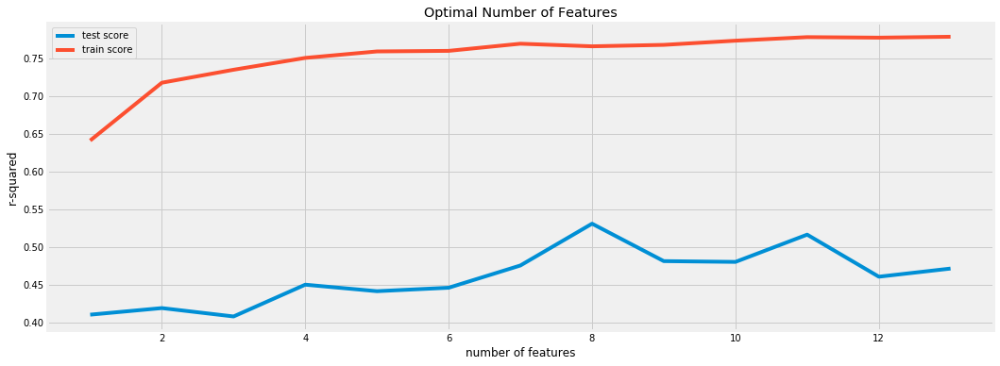

In [67]:
plt.figure(figsize=(16,6))

plt.plot(cv_result["param_n_features_to_select"], cv_result["mean_test_score"])
plt.plot(cv_result["param_n_features_to_select"], cv_result["mean_train_score"])
plt.xlabel('number of features')
plt.ylabel('r-squared')
plt.title("Optimal Number of Features")
plt.legend(['test score', 'train score'], loc='upper left')

Same as Random Forest, AdaBoost need to have 10 features, but after that, it degrades in performance afterwards. 

In [68]:
# Final model - AdaBoost

start_time = time.time()

n_optimal = 10

rfe = RFE(reg_ada, n_features_to_select = n_optimal)             
reg_ada_optima = rfe.fit(X_train, y_train)

finish_time = time.time()
total_time = finish_time - start_time

print('Elapsed time: ', total_time)

Elapsed time:  0.07500100135803223


In [69]:
# R2 score model with hold-out set 
print(metrics.r2_score(y_train, reg_ada.predict(X_train)))
print(metrics.r2_score(y_test, reg_ada.predict(X_test)))

0.7791735900955689
0.36309998400408316


In [70]:
# R2 score model with optimal Ada model 
print(metrics.r2_score(y_train, reg_ada_optima.predict(X_train)))
print(metrics.r2_score(y_test, reg_ada_optima.predict(X_test)))

0.7719443340469082
0.3486735406638878


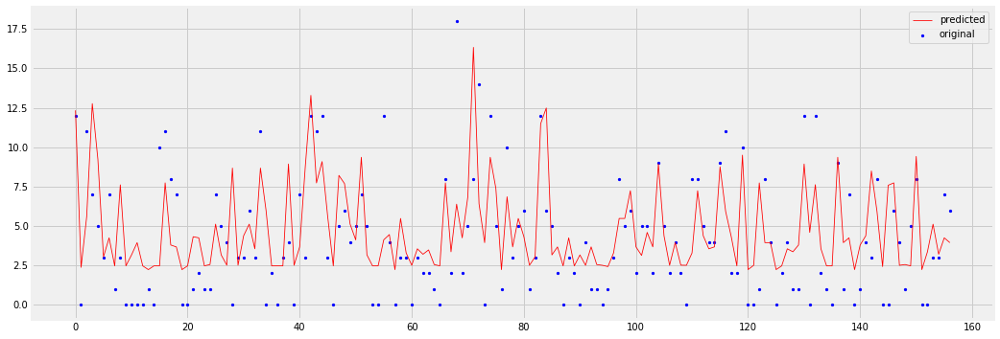

In [71]:
# The AdaBoost model seem to underfit the data

plt.figure(figsize=(16,6))

x_ax = range(len(y_test))
plt.scatter(x_ax, y_test, s = 5, color = "blue", label = "original")
plt.plot(x_ax, reg_ada_optima.predict(X_test), lw = 0.8, color = "red", label = "predicted")
plt.legend()
plt.show()

### 2.2.3 Gradient Boosting Tree

In [72]:
start_time = time.time()

fold = KFold(n_splits = 5, shuffle = True, random_state = 100) 

hyper_params = [{'n_features_to_select': list(range(1, 14))}]

gbt_cv = RFE(reg_gbt)             

reg_gbt_cv = GridSearchCV(estimator = gbt_cv, 
                          param_grid = hyper_params,
                          scoring = 'r2',
                          cv = fold,
                          verbose = 1,
                          return_train_score = True)      

reg_gbt_cv.fit(X_train, y_train)   

finish_time = time.time()
total_time = finish_time - start_time

print('Elapsed time: ', total_time)

Fitting 5 folds for each of 13 candidates, totalling 65 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Elapsed time:  12.94075870513916


[Parallel(n_jobs=1)]: Done  65 out of  65 | elapsed:   12.8s finished


In [73]:
cv_result = pd.DataFrame(reg_gbt_cv.cv_results_)
cv_result

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_features_to_select,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,0.382730,0.009048,0.001795,0.000400,1,{'n_features_to_select': 1},0.587020,0.363051,0.141888,0.539621,0.518405,0.429997,0.162467,13,0.830902,0.851670,0.841825,0.810050,0.814212,0.829732,0.015856
1,0.353423,0.003042,0.001801,0.000408,2,{'n_features_to_select': 2},0.524371,0.361794,0.262694,0.541514,0.648533,0.467781,0.137553,11,0.895325,0.895082,0.892851,0.880574,0.893360,0.891438,0.005515
2,0.331399,0.003730,0.001597,0.000485,3,{'n_features_to_select': 3},0.571131,0.355473,0.299275,0.563026,0.545450,0.466871,0.115575,12,0.914632,0.923015,0.910586,0.904757,0.917059,0.914010,0.006134
3,0.318491,0.011913,0.001809,0.000405,4,{'n_features_to_select': 4},0.607872,0.335361,0.370991,0.526274,0.606532,0.489406,0.115641,7,0.934082,0.932018,0.928585,0.915752,0.926912,0.927470,0.006376
4,0.264661,0.002130,0.001606,0.000492,5,{'n_features_to_select': 5},0.581911,0.300725,0.374588,0.565542,0.631836,0.490920,0.129161,6,0.939190,0.937128,0.931271,0.924329,0.941791,0.934742,0.006255
5,0.232800,0.006080,0.001409,0.000490,6,{'n_features_to_select': 6},0.598107,0.319409,0.355975,0.528339,0.608769,0.482120,0.121669,9,0.942353,0.942159,0.935538,0.931757,0.939482,0.938258,0.004078
6,0.188993,0.002429,0.001806,0.000406,7,{'n_features_to_select': 7},0.603300,0.344877,0.373064,0.510079,0.629743,0.492212,0.116171,5,0.946083,0.946544,0.943483,0.934672,0.945059,0.943168,0.004376
7,0.144593,0.000676,0.001995,0.000005,8,{'n_features_to_select': 8},0.604440,0.373538,0.296507,0.539562,0.597914,0.482392,0.124829,8,0.951942,0.948003,0.949377,0.942074,0.944559,0.947191,0.003496
8,0.097816,0.002293,0.001394,0.000491,9,{'n_features_to_select': 9},0.617972,0.320813,0.314581,0.507181,0.591563,0.470422,0.129974,10,0.947994,0.949619,0.953250,0.946733,0.952105,0.949940,0.002442
9,0.054463,0.003942,0.002014,0.000650,10,{'n_features_to_select': 10},0.613446,0.375843,0.347911,0.523908,0.647913,0.501804,0.121532,1,0.948589,0.956574,0.953123,0.945456,0.954491,0.951647,0.004055


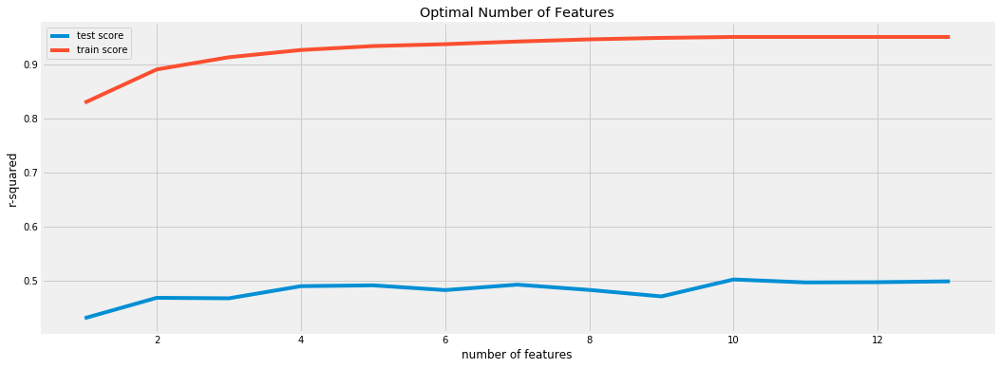

In [74]:
plt.figure(figsize=(16,6))

plt.plot(cv_result["param_n_features_to_select"], cv_result["mean_test_score"])
plt.plot(cv_result["param_n_features_to_select"], cv_result["mean_train_score"])
plt.xlabel('number of features')
plt.ylabel('r-squared')
plt.title("Optimal Number of Features")
plt.legend(['test score', 'train score'], loc='upper left')

In [75]:
# Final model - Gradient Boosting Tree
start_time = time.time()

n_optimal = 8

rfe = RFE(reg_gbt, n_features_to_select = n_optimal)             
reg_gbt_optima = rfe.fit(X_train, y_train)

finish_time = time.time()
total_time = finish_time - start_time

print('Elapsed time: ', total_time)

Elapsed time:  0.1852738857269287


In [76]:
# R2 score model with hold-out set 
print(metrics.r2_score(y_train, reg_gbt.predict(X_train)))
print(metrics.r2_score(y_test, reg_gbt.predict(X_test)))

0.9351287699989937
0.41721040639840223


In [77]:
# R2 score model with optimal Gbt model 
print(metrics.r2_score(y_train, reg_gbt_optima.predict(X_train)))
print(metrics.r2_score(y_test, reg_gbt_optima.predict(X_test)))

0.9293332309705518
0.37729900021210294


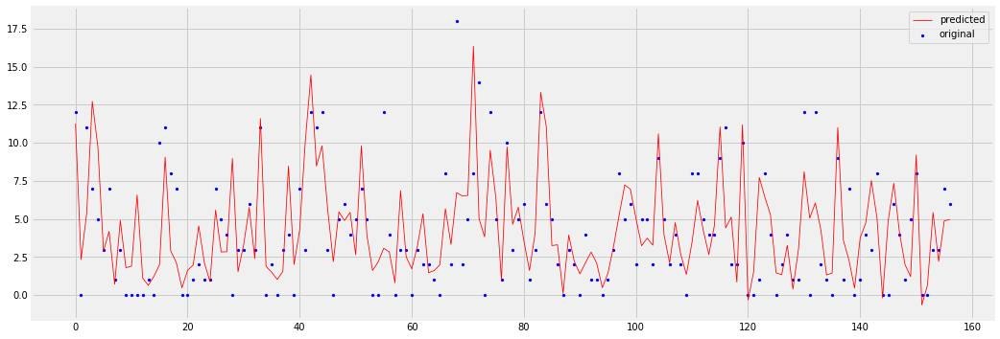

In [78]:
plt.figure(figsize=(16,6))

x_ax = range(len(y_test))
plt.scatter(x_ax, y_test, s = 5, color = "blue", label = "original")
plt.plot(x_ax, reg_gbt_optima.predict(X_test), lw = 0.8, color = "red", label = "predicted")
plt.legend()
plt.show()

### 2.2.4 XGBoost

In [79]:
start_time = time.time()

fold = KFold(n_splits = 5, shuffle = True, random_state = 100) 

hyper_params = [{'n_features_to_select': list(range(1, 14))}]

xgb_cv = RFE(reg_xgb)             

reg_xgb_cv = GridSearchCV(estimator = xgb_cv, 
                          param_grid = hyper_params,
                          scoring = 'r2',
                          cv = fold,
                          verbose = 1,
                          return_train_score = True)      

reg_xgb_cv.fit(X_train, y_train)   

finish_time = time.time()
total_time = finish_time - start_time

print('Elapsed time: ', total_time)

Fitting 5 folds for each of 13 candidates, totalling 65 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Elapsed time:  29.04862141609192


[Parallel(n_jobs=1)]: Done  65 out of  65 | elapsed:   28.9s finished


In [80]:
cv_result = pd.DataFrame(reg_xgb_cv.cv_results_)
cv_result

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_features_to_select,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,1.006211,0.027689,0.003399,0.000490,1,{'n_features_to_select': 1},0.352390,0.315193,-0.202625,0.213870,0.361487,0.208063,0.211917,13,0.958106,0.961934,0.941317,0.939711,0.932920,0.946798,1.122350e-02
1,0.965627,0.072498,0.003601,0.000802,2,{'n_features_to_select': 2},0.611847,0.292585,0.009236,0.326804,0.540527,0.356200,0.211956,11,0.989254,0.979613,0.991736,0.995725,0.995975,0.990461,5.981317e-03
2,0.842623,0.026774,0.003200,0.000399,3,{'n_features_to_select': 3},0.477798,0.268629,-0.045971,0.380756,0.585328,0.333308,0.216646,12,0.999032,0.997126,0.992727,0.996379,0.996630,0.996378,2.049116e-03
3,0.730588,0.015649,0.003400,0.000803,4,{'n_features_to_select': 4},0.441186,0.333953,-0.003830,0.585070,0.564894,0.384255,0.214167,10,0.999933,0.999477,0.999756,0.999232,0.998640,0.999408,4.523428e-04
4,0.637692,0.027543,0.003400,0.000802,5,{'n_features_to_select': 5},0.496188,0.287346,0.054405,0.609078,0.628882,0.415180,0.217406,9,0.999951,0.999975,0.999907,0.999894,0.999936,0.999933,2.946466e-05
5,0.509758,0.011507,0.003001,0.000002,6,{'n_features_to_select': 6},0.535977,0.342815,0.169184,0.614420,0.644729,0.461425,0.180022,6,0.999986,0.999995,0.999991,0.999950,0.999977,0.999980,1.607862e-05
6,0.392175,0.004179,0.003201,0.000400,7,{'n_features_to_select': 7},0.512168,0.354616,0.203892,0.559575,0.595765,0.445203,0.146062,8,0.999996,0.999997,0.999995,0.999993,0.999997,0.999995,1.636885e-06
7,0.277245,0.006634,0.003210,0.000395,8,{'n_features_to_select': 8},0.517044,0.338198,0.368842,0.433334,0.609255,0.453335,0.099162,7,0.999999,1.000000,0.999999,0.999997,0.999999,0.999999,7.834620e-07
8,0.162202,0.002480,0.003198,0.000402,9,{'n_features_to_select': 9},0.499364,0.327463,0.320141,0.657591,0.657606,0.492433,0.149336,5,0.999999,0.999999,0.999998,1.000000,1.000000,0.999999,5.761461e-07
9,0.045199,0.000748,0.003202,0.000400,10,{'n_features_to_select': 10},0.541855,0.413851,0.307952,0.602592,0.626956,0.498641,0.120573,1,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,8.133088e-08


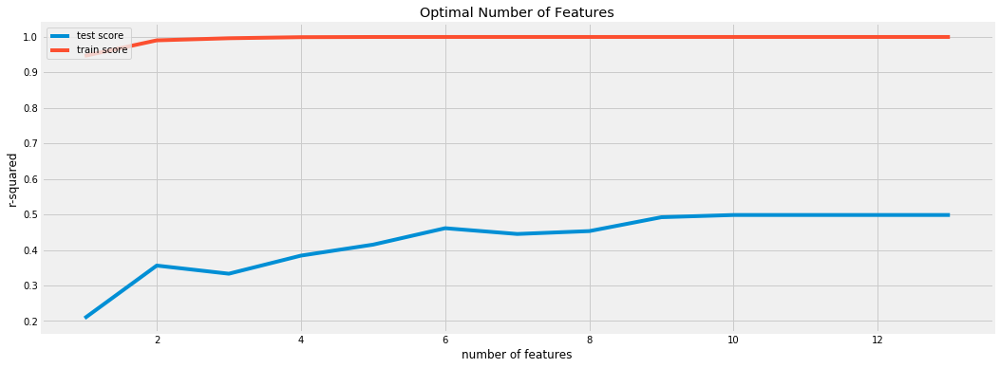

In [81]:
plt.figure(figsize = (16,6))

plt.plot(cv_result["param_n_features_to_select"], cv_result["mean_test_score"])
plt.plot(cv_result["param_n_features_to_select"], cv_result["mean_train_score"])
plt.xlabel('number of features')
plt.ylabel('r-squared')
plt.title("Optimal Number of Features")
plt.legend(['test score', 'train score'], loc='upper left')

In [82]:
# Final model - XGBoost
start_time = time.time()

n_optimal = 10

rfe = RFE(reg_xgb, n_features_to_select = n_optimal)             
reg_xgb_optima = rfe.fit(X_train, y_train)

finish_time = time.time()
total_time = finish_time - start_time

print('Elapsed time: ', total_time)

Elapsed time:  0.045996665954589844


In [83]:
# R2 score model with hold-out set 
print(metrics.r2_score(y_train, reg_xgb.predict(X_train)))
print(metrics.r2_score(y_test, reg_xgb.predict(X_test)))

0.9999984351191241
0.36037902664839117


In [84]:
# R2 score model with optimal Ada model 
print(metrics.r2_score(y_train, reg_xgb_optima.predict(X_train)))
print(metrics.r2_score(y_test, reg_xgb_optima.predict(X_test)))

0.9999984351191241
0.36037902664839117


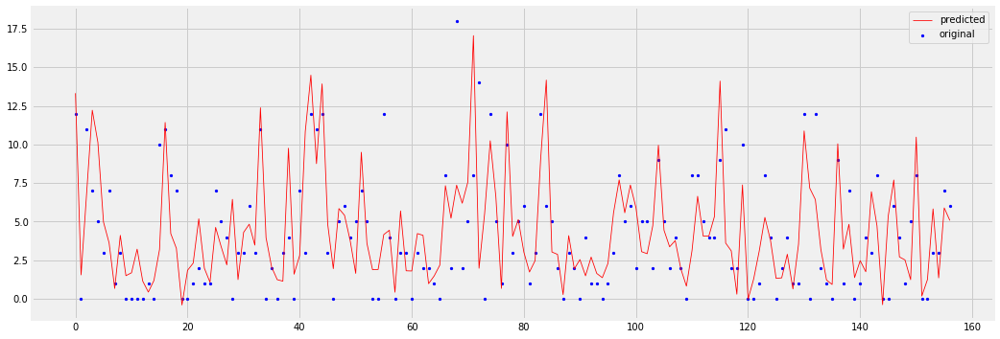

In [85]:
plt.figure(figsize = (16,6))

x_ax = range(len(y_test))
plt.scatter(x_ax, y_test, s = 5, color = "blue", label = "original")
plt.plot(x_ax, reg_xgb_optima.predict(X_test), lw = 0.8, color = "red", label = "predicted")
plt.legend()
plt.show()

### 2.2.5 CatBoost

In [86]:
start_time = time.time()

fold = KFold(n_splits = 5, shuffle = True, random_state = 100) 

hyper_params = [{'n_features_to_select': list(range(1, 14))}]

cat_cv = RFE(reg_cat)             

reg_cat_cv = GridSearchCV(estimator = cat_cv, 
                          param_grid = hyper_params,
                          scoring = 'r2',
                          cv = fold,
                          verbose = 1,
                          return_train_score = True)      

reg_cat_cv.fit(X_train, y_train)   

finish_time = time.time()
total_time = finish_time - start_time

print('Elapsed time: ', total_time)

Fitting 5 folds for each of 13 candidates, totalling 65 fits
Learning rate set to 0.032503
0:	learn: 4.6085157	total: 1.48ms	remaining: 1.48s
1:	learn: 4.5492756	total: 2.9ms	remaining: 1.45s
2:	learn: 4.4953731	total: 4.18ms	remaining: 1.39s
3:	learn: 4.4423108	total: 5.52ms	remaining: 1.37s
4:	learn: 4.3886072	total: 7ms	remaining: 1.39s
5:	learn: 4.3339550	total: 8.46ms	remaining: 1.4s
6:	learn: 4.2857518	total: 9.76ms	remaining: 1.38s
7:	learn: 4.2352107	total: 11.3ms	remaining: 1.41s
8:	learn: 4.1901440	total: 12.6ms	remaining: 1.39s
9:	learn: 4.1402708	total: 14.3ms	remaining: 1.42s
10:	learn: 4.0932554	total: 16.3ms	remaining: 1.47s
11:	learn: 4.0543234	total: 17.8ms	remaining: 1.47s
12:	learn: 4.0133587	total: 19.1ms	remaining: 1.45s
13:	learn: 3.9647062	total: 20.4ms	remaining: 1.44s
14:	learn: 3.9143203	total: 21.5ms	remaining: 1.41s
15:	learn: 3.8654310	total: 22.8ms	remaining: 1.4s
16:	learn: 3.8197821	total: 24.1ms	remaining: 1.39s
17:	learn: 3.7872652	total: 25.4ms	remain

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


102:	learn: 2.2804357	total: 142ms	remaining: 1.24s
103:	learn: 2.2740078	total: 144ms	remaining: 1.24s
104:	learn: 2.2630737	total: 145ms	remaining: 1.24s
105:	learn: 2.2538359	total: 146ms	remaining: 1.24s
106:	learn: 2.2514579	total: 147ms	remaining: 1.23s
107:	learn: 2.2421330	total: 148ms	remaining: 1.22s
108:	learn: 2.2342295	total: 149ms	remaining: 1.22s
109:	learn: 2.2272148	total: 151ms	remaining: 1.22s
110:	learn: 2.2181720	total: 152ms	remaining: 1.22s
111:	learn: 2.2100061	total: 154ms	remaining: 1.22s
112:	learn: 2.1980393	total: 155ms	remaining: 1.22s
113:	learn: 2.1896225	total: 156ms	remaining: 1.21s
114:	learn: 2.1825902	total: 157ms	remaining: 1.21s
115:	learn: 2.1754928	total: 158ms	remaining: 1.21s
116:	learn: 2.1671094	total: 159ms	remaining: 1.2s
117:	learn: 2.1614143	total: 162ms	remaining: 1.21s
118:	learn: 2.1509879	total: 163ms	remaining: 1.21s
119:	learn: 2.1450799	total: 164ms	remaining: 1.2s
120:	learn: 2.1375352	total: 165ms	remaining: 1.2s
121:	learn: 2.1

[Parallel(n_jobs=1)]: Done  65 out of  65 | elapsed:  7.4min finished


21:	learn: 3.6146049	total: 33.5ms	remaining: 1.49s
22:	learn: 3.5804896	total: 35.5ms	remaining: 1.51s
23:	learn: 3.5513331	total: 37ms	remaining: 1.5s
24:	learn: 3.5170087	total: 38.6ms	remaining: 1.51s
25:	learn: 3.4864711	total: 40.3ms	remaining: 1.51s
26:	learn: 3.4604931	total: 41.8ms	remaining: 1.51s
27:	learn: 3.4296275	total: 43.5ms	remaining: 1.51s
28:	learn: 3.4025128	total: 45ms	remaining: 1.51s
29:	learn: 3.3754625	total: 46.5ms	remaining: 1.5s
30:	learn: 3.3446322	total: 48.1ms	remaining: 1.5s
31:	learn: 3.3119720	total: 49.6ms	remaining: 1.5s
32:	learn: 3.2885173	total: 51.7ms	remaining: 1.51s
33:	learn: 3.2659910	total: 53.3ms	remaining: 1.51s
34:	learn: 3.2387539	total: 54.7ms	remaining: 1.51s
35:	learn: 3.2081601	total: 56.1ms	remaining: 1.5s
36:	learn: 3.1850572	total: 57.4ms	remaining: 1.49s
37:	learn: 3.1623168	total: 58.9ms	remaining: 1.49s
38:	learn: 3.1354895	total: 60.5ms	remaining: 1.49s
39:	learn: 3.1139696	total: 61.8ms	remaining: 1.48s
40:	learn: 3.0865074	

In [87]:
cv_result = pd.DataFrame(reg_cat_cv.cv_results_)
cv_result

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_features_to_select,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,13.132974,0.415231,0.003008,0.000010,1,{'n_features_to_select': 1},0.612602,0.357284,0.158437,0.518951,0.515651,0.432585,0.159745,11,0.827174,0.852987,0.845971,0.816907,0.827966,0.834201,0.013257
1,13.861295,0.834389,0.003244,0.001041,2,{'n_features_to_select': 2},0.557661,0.338150,0.275074,0.574374,0.472625,0.443577,0.118722,10,0.930570,0.933484,0.937487,0.931909,0.933323,0.933355,0.002321
2,13.670722,1.362609,0.003615,0.000787,3,{'n_features_to_select': 3},0.449006,0.355017,0.219970,0.524984,0.545550,0.418906,0.119879,13,0.963678,0.975314,0.967761,0.961233,0.967179,0.967033,0.004775
3,10.091862,0.229865,0.002402,0.000496,4,{'n_features_to_select': 4},0.456517,0.307194,0.268234,0.503456,0.601430,0.427366,0.123857,12,0.975333,0.988164,0.982617,0.986566,0.977407,0.982017,0.004995
4,9.016617,0.381285,0.003605,0.000794,5,{'n_features_to_select': 5},0.481300,0.385303,0.365617,0.558932,0.553556,0.468942,0.081341,9,0.987351,0.991118,0.991286,0.991074,0.987513,0.989668,0.001828
5,7.442958,0.106205,0.003415,0.000485,6,{'n_features_to_select': 6},0.491815,0.403485,0.447775,0.646748,0.560260,0.510017,0.085760,7,0.989632,0.992773,0.993125,0.990592,0.994540,0.992132,0.001779
6,6.100951,0.095677,0.003215,0.000402,7,{'n_features_to_select': 7},0.514147,0.414402,0.410193,0.643123,0.556423,0.507657,0.088280,8,0.992336,0.993768,0.995682,0.991903,0.995287,0.993795,0.001516
7,4.889213,0.394461,0.003605,0.001019,8,{'n_features_to_select': 8},0.555914,0.430473,0.414820,0.597983,0.575919,0.515022,0.076749,6,0.994497,0.995532,0.996265,0.994052,0.995774,0.995224,0.000823
8,3.112210,0.103182,0.003204,0.000409,9,{'n_features_to_select': 9},0.540654,0.481235,0.393994,0.646257,0.613142,0.535057,0.090873,5,0.995146,0.996916,0.996254,0.994140,0.996850,0.995861,0.001069
9,1.783109,0.068384,0.003803,0.001163,10,{'n_features_to_select': 10},0.560203,0.457522,0.451452,0.654657,0.619508,0.548668,0.082636,1,0.995288,0.997027,0.996015,0.994659,0.996833,0.995965,0.000900


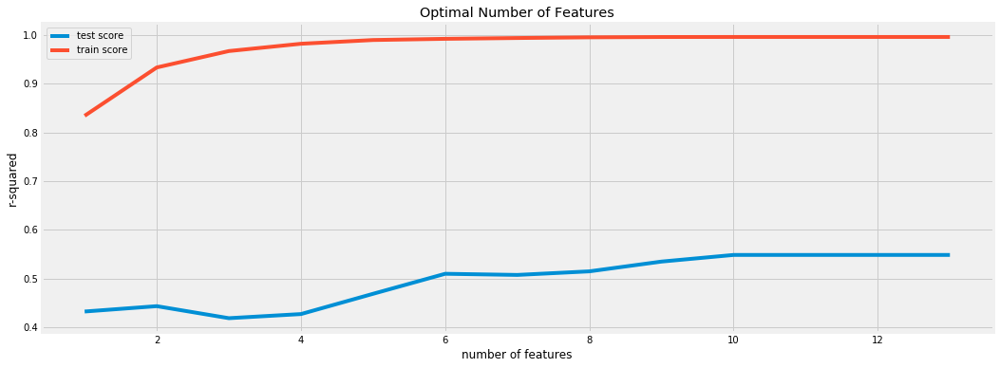

In [88]:
plt.figure(figsize = (16,6))

plt.plot(cv_result["param_n_features_to_select"], cv_result["mean_test_score"])
plt.plot(cv_result["param_n_features_to_select"], cv_result["mean_train_score"])
plt.xlabel('number of features')
plt.ylabel('r-squared')
plt.title("Optimal Number of Features")
plt.legend(['test score', 'train score'], loc = 'upper left')

In [89]:
# Final model - CatBoost
start_time = time.time()

n_optimal = 10

rfe = RFE(reg_cat, n_features_to_select = n_optimal)             
reg_cat_optima = rfe.fit(X_train, y_train)

finish_time = time.time()
total_time = finish_time - start_time

print('Elapsed time: ', total_time)

Learning rate set to 0.03367
0:	learn: 4.6882534	total: 1.51ms	remaining: 1.5s
1:	learn: 4.6165401	total: 3.31ms	remaining: 1.65s
2:	learn: 4.5488172	total: 6.65ms	remaining: 2.21s
3:	learn: 4.4864182	total: 8.79ms	remaining: 2.19s
4:	learn: 4.4201873	total: 10.5ms	remaining: 2.09s
5:	learn: 4.3603510	total: 12.1ms	remaining: 2.01s
6:	learn: 4.3105156	total: 13.5ms	remaining: 1.92s
7:	learn: 4.2586735	total: 15ms	remaining: 1.86s
8:	learn: 4.2058929	total: 16.5ms	remaining: 1.82s
9:	learn: 4.1500706	total: 17.8ms	remaining: 1.76s
10:	learn: 4.0940087	total: 19.2ms	remaining: 1.72s
11:	learn: 4.0449058	total: 20.6ms	remaining: 1.69s
12:	learn: 3.9959178	total: 22.1ms	remaining: 1.68s
13:	learn: 3.9442423	total: 23.4ms	remaining: 1.65s
14:	learn: 3.8963066	total: 24.8ms	remaining: 1.63s
15:	learn: 3.8487980	total: 26.2ms	remaining: 1.61s
16:	learn: 3.8044273	total: 27.9ms	remaining: 1.61s
17:	learn: 3.7692755	total: 30.2ms	remaining: 1.64s
18:	learn: 3.7299439	total: 31.8ms	remaining: 1.

In [90]:
# R2 score model with hold-out set 
print(metrics.r2_score(y_train, reg_cat.predict(X_train)))
print(metrics.r2_score(y_test, reg_cat.predict(X_test)))

0.99321193180717
0.35936905178100886


In [91]:
# R2 score model with optimal Ada model 
print(metrics.r2_score(y_train, reg_cat_optima.predict(X_train)))
print(metrics.r2_score(y_test, reg_cat_optima.predict(X_test)))

0.99321193180717
0.35936905178100886


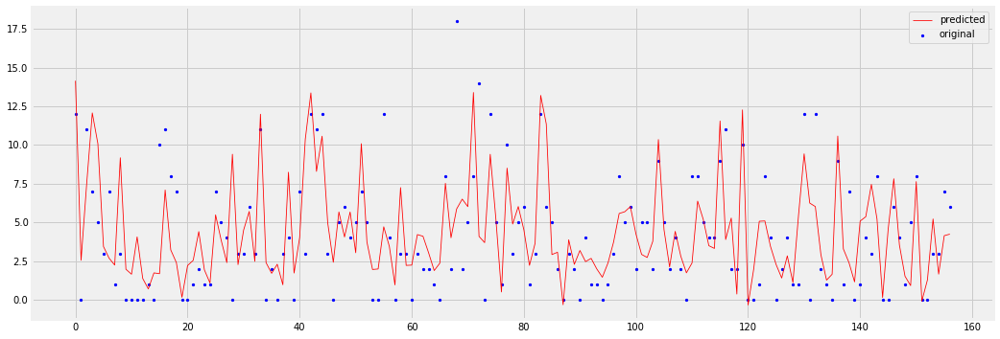

In [92]:
plt.figure(figsize = (16,6))

x_ax = range(len(y_test))
plt.scatter(x_ax, y_test, s = 5, color = "blue", label = "original")
plt.plot(x_ax, reg_cat_optima.predict(X_test), lw = 0.8, color = "red", label = "predicted")
plt.legend()
plt.show()